## __Plato Notebook 3: Slab pull optimisation__

Thomas Schouten, Whitney Behr, Edward Clennett, Thorsten Becker


#### __0. Prepare Python__

First, we load the required packages.

In [78]:
import os
import sys
import numpy as np
import pandas as pd
import xarray as xr
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.colors as mcolors
from matplotlib.patches import Polygon
from scipy.signal import correlate

sys.path.append(os.path.abspath(os.path.join(os.getcwd(), "..")))

from plato.optimisation import Optimisation
from plato.plate_torques import PlateTorques
from plato.plot import PlotReconstruction

#### __1. Set up the PlateTorques object__

The below cell loads a `PlateTorques` object for the Müller et al. (2016) reconstruction by providing the ages of interest and the model string identifier "Muller2016", which automatically downloads the relevant files from the GPlately DataServer.

To accelerate the initialisation, the seafloor age and continental grids are loaded from the sample data folder. The seafloor age grids were obtained from the GPlately DataServer; the continental grids were obtained by reconstructing the present-day elevation as well as the depths of the Moho and lithosphere-asthenosphere (LAB) boundary from Lithoref (Afonso et al., 2019) using the `reconstruct` method of the GPlately `Raster` object.

In [ ]:
# Set parameters
TEST_RUN = False        # Whether or not to run a small sample of ages
COMPUTE_TORQUES = False  # Whether or not to compute torques
OPTIMISE_TORQUES = False # Whether or not to optimise torques
PLOT_FIGS = True        # Whether or not to plot the results

# Plate reconstruction
reconstruction_name = "Muller2016" 

# Reconstruction ages of interest
if TEST_RUN:
    ages = [0, 60]
else:
    ages = np.arange(0, 91, 1)

# Plates of interest
plateIDs = [902, 903, 904, 909, 911, 918, 926]
plate_names = ["Farallon", "Juan de Fuca", "Aluk", "Cocos", "Nazca", "Kula", "Izanagi"]

# Load excel file with settings
settings_file = os.path.join(os.getcwd(), "settings.xlsx")

# Set directory with sample data
data_dir = os.path.abspath(os.path.join(os.getcwd(), "..", "sample_data", "M2016"))

# Set directory to save the results
results_dir = os.path.abspath(os.path.join(os.getcwd(), "..", "..", "output_notebooks", "04-Slab_pull_optimisation"))

# Set directory to save the figures
figs_dir = os.path.abspath(os.path.join(os.getcwd(), "..", "..", "figures_notebooks", "04-Slab_pull_optimisation"))

# Load seafloor age and continental grids
seafloor_age_grids = {}; continental_grids = {}
for age in ages:
    seafloor_age_grids[age] = xr.open_dataset(os.path.join(data_dir, "seafloor_age_grids", f"M2016_SeafloorAgeGrid_{age}Ma.nc"))

# Plotting parameters
cm2in = 0.3937008
fig_width = 18*cm2in*2; fig_height_graphs = 8*cm2in*2; fig_height_maps = 10*cm2in*2
plt.rcParams["font.size"] = 12
plt.rcParams["font.family"] = "Arial"
title_fontsize = 20
plot_times = [45, 60, 75, 90]
projection = ccrs.Robinson(central_longitude = 160) 
annotations = ["a", "b", "c", "d"]

In [80]:
# Set up PlateTorques objects
M2016 = PlateTorques(
    reconstruction_name = "Muller2016",
    ages = ages,
    cases_file = settings_file,
    cases_sheet = "4 - Slab pull optimisation",
    files_dir = results_dir,
    rotation_file = os.path.join(data_dir, "gplates_files", "M2016_rotations_Lr-Hb.rot"),
    topology_file = os.path.join(data_dir, "gplates_files", "M2016_topologies.gpml"),
    polygon_file = os.path.join(data_dir, "gplates_files",  "M2016_static_polygons.gpml"),
    seafloor_age_grids = seafloor_age_grids,
)

KeyboardInterrupt: 

#### __2. Sampling and LAB depth calculation__

The below cell calls the `sample_all` method of the `PlateTorques` object to sample seafloor ages at subduction zones and grid points.

In [ ]:
# If test run, do no include Pacific and India
if COMPUTE_TORQUES and TEST_RUN:
    M2016.sample_slab_seafloor_ages(plateIDs = plateIDs)

elif COMPUTE_TORQUES:
    # For 0-35 Ma, include Pacific and Philippine Sea Plate
    M2016.sample_slab_seafloor_ages(ages = np.arange(0, 36, 1), plateIDs = plateIDs + [608, 901])
                                    
    # For 35-45 Ma, include Pacific
    M2016.sample_slab_seafloor_ages(ages = np.arange(36, 46, 1), plateIDs = plateIDs + [901])

    # For 46-55 Ma, include Pacific and India
    M2016.sample_slab_seafloor_ages(ages = np.arange(46, 56, 1), plateIDs = plateIDs + [501, 901])

    # For 56-91 Ma, include India
    M2016.sample_slab_seafloor_ages(ages = np.arange(56, 91, 1), plateIDs = plateIDs + [501])

#### __3. Removing net rotation__

The below cell removes the net lithospheric rotation component of plate motion using the `remove_net_rotation` method of the `PlateTorques` object.

In [ ]:
if COMPUTE_TORQUES:
    # Get all non-synthetic NNR cases
    nnr_cases = [case for case in M2016.cases if "nnr" in case and "syn" not in case]

    # Remove net rotation for all NNR cases
    M2016.remove_net_rotation(cases = nnr_cases)

#### __4. Torque calculation__

The below cell uses the `calculate_all_torques` method of the `PlateTorques` object to compute the full torque balance for all cases with reconstructed motions.

In [ ]:
# Calculate all torques
if COMPUTE_TORQUES:
    M2016.calculate_all_torques()

#### __5. Optimisation__

The below cells initialise an `Optimisation` object, that contains methods to optimise the free parameters in the plate torque balance, using the `PlateTorques` object.

Then

In [ ]:
# Initialise Optimisation object
optimise_M2016 = Optimisation(M2016)

In [ ]:
# Simple optimisation
if OPTIMISE_TORQUES and TEST_RUN:
    optimise_M2016.optimise_slab_pull_constant(cases = ["opt1", "opt1_nnr"], plateIDs = plateIDs)

elif OPTIMISE_TORQUES:
    # For 0-35 Ma, include Pacific and Philippine Sea Plate
    optimise_M2016.optimise_slab_pull_constant(ages = np.arange(0, 36, 1), cases = ["opt1", "opt1_nnr"], plateIDs = plateIDs + [608, 901])

    # For 36-45 Ma, include Pacific
    optimise_M2016.optimise_slab_pull_constant(ages = np.arange(36, 46, 1), cases = ["opt1", "opt1_nnr"], plateIDs = plateIDs + [901])

    # For 55-46 Ma, include Pacific and India
    optimise_M2016.optimise_slab_pull_constant(ages = np.arange(46, 56, 1), cases = ["opt1", "opt1_nnr"], plateIDs = plateIDs + [501, 901])

    # For 90-56 Ma, include India
    optimise_M2016.optimise_slab_pull_constant(ages = np.arange(56, 91, 1), cases = ["opt1", "opt1_nnr"], plateIDs = plateIDs + [501])

Calculating RMS velocities: 100%|██████████| 1/1 [00:00<00:00, 253.11it/s]
Invalid limit will be ignored.


Text(0, 0.5, 'Synthetic spin rate/\nReconstructed velocity')

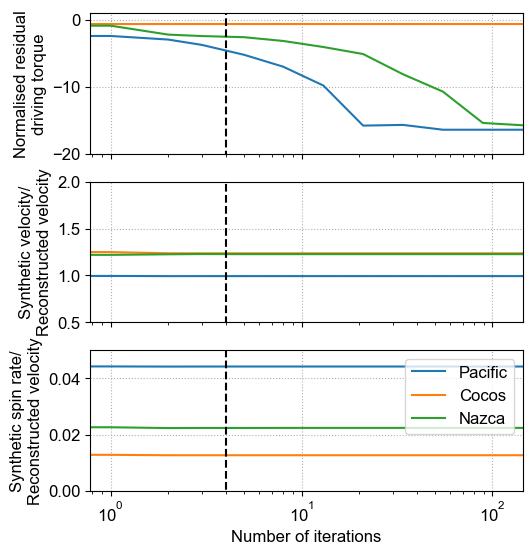

In [124]:
# Test how many iterations are needed
rec_v_rms = {901: [], 909: [], 911: []}
rec_omega_rms = {901: [], 909: [], 911: []}
for plateID in [901, 909, 911]:
    rec_v_rms[plateID].append(
        M2016.plates.data[0]["ref"][M2016.plates.data[0]["ref"].plateID == plateID].velocity_rms_mag.values[0]
    )
    rec_omega_rms[plateID].append(
        M2016.plates.data[0]["ref"][M2016.plates.data[0]["ref"].plateID == plateID].spin_rate_rms_mag.values[0]
    )

num_iterations = [0, 1, 2, 3, 5, 8, 13, 21, 34, 55, 89, 144]
syn_v_rms = {901: [], 909: [], 911: []}
syn_omega_rms = {901: [], 909: [], 911: []}
residual_torque = {901: [], 909: [], 911: []}
driving_torque = {901: [], 909: [], 911: []}

for num_iter in num_iterations:
    optimise_M2016.invert_residual_torque_v4(ages = 0, plateIDs = [901, 909, 911], cases = ["ref"], NUM_ITERATIONS=num_iter)
    for case in M2016.cases:
        if case == "syn" or "syn" in case:
            continue

        M2016.slabs.data[0][f"syn_{case}"].slab_pull_constant = M2016.slabs.data[0][case].slab_pull_constant

    M2016.calculate_all_torques(ages = 0, cases = ["syn_ref"], plateIDs = [901, 909, 911])
    M2016.calculate_synthetic_velocity(ages = 0, cases = ["syn_ref"], plateIDs = [901, 909, 911])

    for plateID in [901, 909, 911]:
        syn_v_rms[plateID].append(
            M2016.plates.data[0]["syn_ref"][M2016.plates.data[0]["syn_ref"].plateID == plateID].velocity_rms_mag.values[0]
        )
        syn_omega_rms[plateID].append(
            M2016.plates.data[0]["syn_ref"][M2016.plates.data[0]["syn_ref"].plateID == plateID].spin_rate_rms_mag.values[0]
        )
        residual_torque[plateID].append(
            M2016.plates.data[0]["ref"][M2016.plates.data[0]["ref"].plateID == plateID].residual_torque_mag.values[0]
        )
        driving_torque[plateID].append(
            M2016.plates.data[0]["ref"][M2016.plates.data[0]["ref"].plateID == plateID].driving_torque_mag.values[0]
        )

Invalid limit will be ignored.


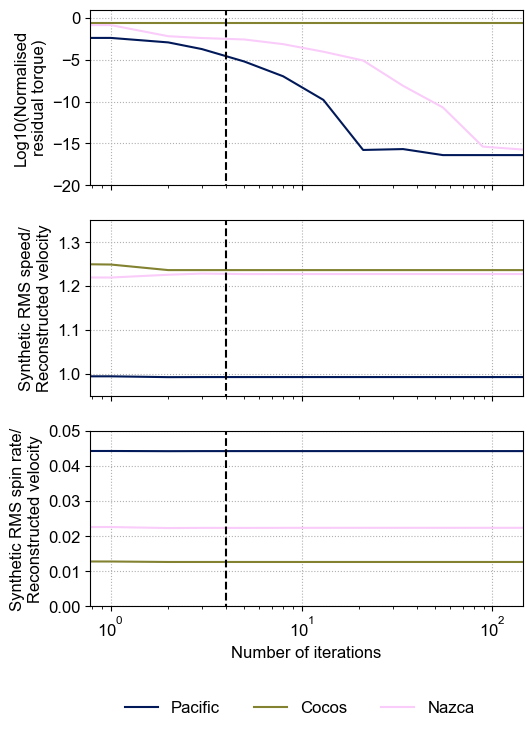

In [172]:
# Get colours
plate_colours = plt.get_cmap("cmc.batlow")(np.linspace(0, 1, 3))

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(fig_width*cm2in, fig_height_maps*cm2in*2.5))
for k, (plateID, plate_name) in enumerate(zip([901, 909, 911], ["Pacific", "Cocos", "Nazca"])):
    ax1.plot(
        num_iterations,
        np.log10(
            np.array(residual_torque[plateID])/
            np.array(driving_torque[plateID]),
        ),
        label=f"{plate_name}",
        c=plate_colours[k],
    )
    ax2.plot(
        num_iterations,
        np.array(syn_v_rms[plateID])/np.array(rec_v_rms[plateID][0]),
        label=f"{plate_name}",
        c=plate_colours[k],
    )
    ax3.plot(
        num_iterations,
        np.array(syn_omega_rms[plateID])/np.array(rec_v_rms[plateID][0]),
        label=f"{plate_name}",
        c=plate_colours[k],
    )

for ax in [ax1, ax2, ax3]:
    ax.set_xscale("log")
    ax.grid(ls=":")
    ax.set_xlim([num_iterations[0], num_iterations[-1]])
    ax.vlines(4, ymin=-1e99, ymax=1e99, color="k", linestyle="--")

ax1.set_ylim([-20, 1])
ax2.set_ylim([0.95, 1.35])
ax3.set_ylim([0, 0.05])
ax1.set_xticklabels([])
ax2.set_xticklabels([])
ax3.set_xlabel("Number of iterations")
ax1.set_ylabel("Log10(Normalised\nresidual torque)")
ax2.set_ylabel("Synthetic RMS speed/\nReconstructed velocity")
ax3.set_ylabel("Synthetic RMS spin rate/\nReconstructed velocity")

# Add a legend below the entire figure
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc="lower center", ncol=4, frameon=False, bbox_to_anchor=(0.5, -0.05))

fig.savefig(os.path.join(figs_dir, "Num_iterations.png"), bbox_inches="tight")


In [ ]:
# Complex optimisation
# Define number of iterations
NUM_ITERATIONS = 4

if OPTIMISE_TORQUES and TEST_RUN:
    optimise_M2016.invert_residual_torque_v4(cases = ["opt2", "opt2_nnr"], plateIDs = plateIDs, NUM_ITERATIONS = NUM_ITERATIONS)

elif OPTIMISE_TORQUES:
    # For 0-35 Ma, include Pacific and Philippine Sea Plate
    optimise_M2016.invert_residual_torque_v4(ages = np.arange(0, 36), cases = ["opt2", "opt2_nnr"], plateIDs = plateIDs + [608, 901], NUM_ITERATIONS = NUM_ITERATIONS)

    # For 36-45 Ma, include Pacific
    optimise_M2016.invert_residual_torque_v4(ages = np.arange(36, 46), cases = ["opt2", "opt2_nnr"], plateIDs = plateIDs + [901], NUM_ITERATIONS = NUM_ITERATIONS)

    # For 46-55 Ma, include Pacific and India
    optimise_M2016.invert_residual_torque_v4(ages = np.arange(46, 56), cases = ["opt2", "opt2_nnr"], plateIDs = plateIDs + [501, 901], NUM_ITERATIONS = NUM_ITERATIONS)

    # For 56-90 Ma, include India
    optimise_M2016.invert_residual_torque_v4(ages = np.arange(56, 91), cases = ["opt2", "opt2_nnr"], plateIDs = plateIDs + [501], NUM_ITERATIONS = NUM_ITERATIONS)

#### __6. Synthetic velocities__

The below cells 

In [ ]:
# Copy slab pull constants to synthetic cases
if OPTIMISE_TORQUES:
    for age in M2016.ages:
        for case in M2016.cases:
            if "syn" in case:
                continue

            M2016.slabs.data[age][f"syn_{case}"]["slab_pull_constant"] = M2016.slabs.data[age][case]["slab_pull_constant"].copy()
            M2016.calculate_all_torques(ages = age, cases = f"syn_{case}", PROGRESS_BAR = False)
            M2016.calculate_synthetic_velocity(ages = age, cases = f"syn_{case}", PROGRESS_BAR = False)

In [ ]:
if COMPUTE_TORQUES:
    for age in M2016.ages:
        for case in M2016.cases:
            if "syn" in case:
                continue

            M2016.slabs.data[age][f"syn_{case}"]["slab_pull_constant"] = M2016.slabs.data[age][case]["slab_pull_constant"].copy()
            M2016.calculate_all_torques(ages = age, cases = f"syn_{case}", PROGRESS_BAR = False)
            M2016.calculate_synthetic_velocity(ages = age, cases = f"syn_{case}", PROGRESS_BAR = False)

In [ ]:
# Save all data if the torques have been computed
if COMPUTE_TORQUES or OPTIMISE_TORQUES and not TEST_RUN:
    M2016.save_all()

#### __7. Visualisation__

The below cells 

In [ ]:
# Extract reconstructed RMS velocity components
rms_speed = M2016.extract_data_through_time(plateIDs = plateIDs + [501, 608, 901], var = "velocity_rms_mag")
rms_spin_rate = M2016.extract_data_through_time(plateIDs = plateIDs + [501, 608, 901], var = "spin_rate_rms_mag")

# Extract optimised torques for each case
driving_torque = M2016.extract_data_through_time(plateIDs = plateIDs + [501, 608, 901], var = "driving_torque_mag", cases = ["ref", "opt1", "opt2", "ref_nnr", "opt1_nnr", "opt2_nnr"])
residual_torque = M2016.extract_data_through_time(plateIDs = plateIDs + [501, 608, 901], var = "residual_torque_mag", cases = ["ref", "opt1", "opt2", "ref_nnr", "opt1_nnr", "opt2_nnr"])

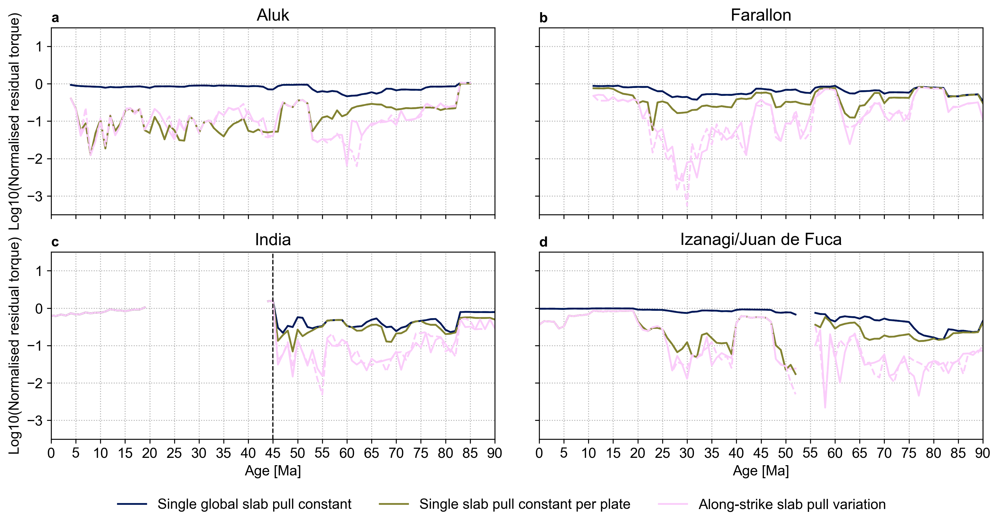

In [ ]:
# Create a figure and gridspec
fig = plt.figure(figsize=(fig_width, fig_height_graphs), dpi=300)
gs = gridspec.GridSpec(2, 2, width_ratios=[1, 1], height_ratios=[1, 1], wspace=0.1, hspace=0.2)

plot_plateIDs = [904, 902, 501, 926]
plot_plate_names = ["Aluk", "Farallon", "India", "Izanagi/Juan de Fuca"]

optimisation_colours = plt.get_cmap("cmc.batlow")(np.linspace(0, 1, 3))
optimisation_labels = ["Single global slab pull constant", "Single slab pull constant per plate", "Along-strike slab pull variation"]

# Plot the residual torques
m = 0
for i in range(2):
    for j in range(2):
        ax = plt.subplot(gs[i, j])
        ax.set_title(f"{plot_plate_names[m]}")
        for k, case in enumerate(["ref", "opt1", "opt2"]):
            ax.plot(
                residual_torque[case]["Age"],
                np.log10(residual_torque[case][plot_plateIDs[m]]/driving_torque[case][plot_plateIDs[m]]),
                c = optimisation_colours[k],
                label = optimisation_labels[k],
            )
            if plot_plateIDs[m] == 926:
                ax.plot(
                    residual_torque[case]["Age"],
                    np.log10(residual_torque[case][903]/driving_torque[case][903]),
                    c = optimisation_colours[k],
                )

        for k, case in enumerate(["ref_nnr", "opt1_nnr", "opt2_nnr"]):
            ax.plot(
                residual_torque[case]["Age"],
                np.log10(residual_torque[case][plot_plateIDs[m]]/driving_torque[case][plot_plateIDs[m]]),
                c = optimisation_colours[k],
                ls = "--",
            )
            if plot_plateIDs[m] == 926:
                ax.plot(
                    residual_torque[case]["Age"],
                    np.log10(residual_torque[case][903]/driving_torque[case][903]),
                    c = optimisation_colours[k],
                    ls = "--",
                )
        
        if plot_plateIDs[m] == 501:
            ax.vlines(45, -3.5, 1.5, color="k", ls="--", lw=1)

        ax.grid(ls=":")
        
        ax.set_xlim(residual_torque[case]["Age"].min(), residual_torque[case]["Age"].max())
        ax.set_ylim(-3.5, 1.5)

        ax.set_xticks(np.arange(residual_torque[case]["Age"].min(), residual_torque[case]["Age"].max()+1, 5))

        ax.set_xticklabels([]) if i == 0 else None
        ax.set_yticklabels([]) if j == 1 else None

        ax.set_xlabel("Age [Ma]") if i == 1 else None
        ax.set_ylabel("Log10(Normalised residual torque)") if j == 0 else None

        ax.annotate(annotations[m], xy=(0, 1.03), xycoords="axes fraction", fontweight="bold")

        m += 1

# Add a legend below the entire figure
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc="lower center", ncol=4, frameon=False, bbox_to_anchor=(0.5, -0.05))

fig.savefig(os.path.join(figs_dir, "M2016_optimised_residual_torques_1.png"), bbox_inches="tight")

plt.show()

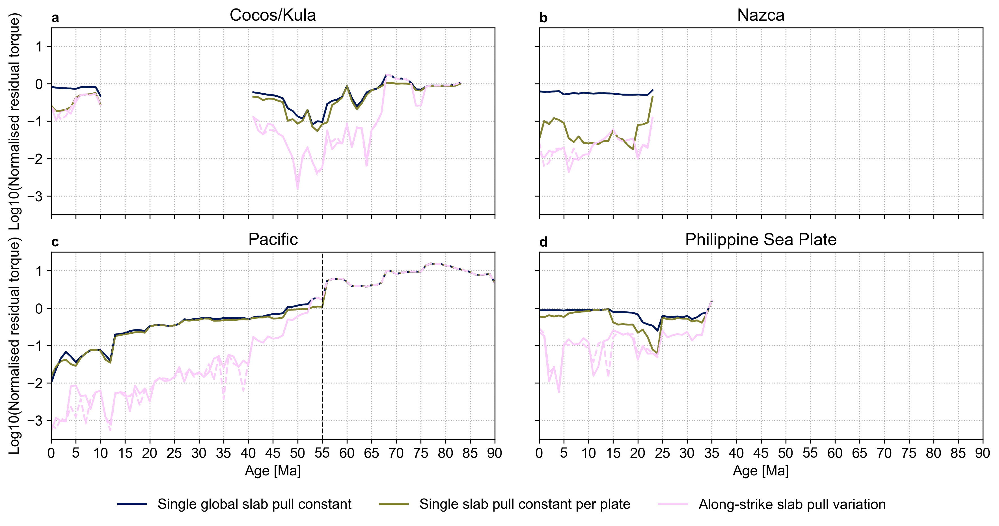

In [ ]:
# Create a figure and gridspec
fig = plt.figure(figsize=(fig_width, fig_height_graphs), dpi=300)
gs = gridspec.GridSpec(2, 2, width_ratios=[1, 1], height_ratios=[1, 1], wspace=0.1, hspace=0.2)

plot_plateIDs = [909, 911, 901, 608]
plot_plate_names = ["Cocos/Kula", "Nazca", "Pacific", "Philippine Sea Plate"]

optimisation_colours = plt.get_cmap("cmc.batlow")(np.linspace(0, 1, 3))
optimisation_labels = ["Single global slab pull constant", "Single slab pull constant per plate", "Along-strike slab pull variation"]

# Plot the residual torques
m = 0
for i in range(2):
    for j in range(2):
        ax = plt.subplot(gs[i, j])
        ax.set_title(f"{plot_plate_names[m]}")
        for k, case in enumerate(["ref", "opt1", "opt2"]):
            ax.plot(
                residual_torque[case]["Age"],
                np.log10(residual_torque[case][plot_plateIDs[m]]/driving_torque[case][plot_plateIDs[m]]),
                c = optimisation_colours[k],
                label = optimisation_labels[k],
            )
            if plot_plateIDs[m] == 909:
                ax.plot(
                    residual_torque[case]["Age"],
                    np.log10(residual_torque[case][918]/driving_torque[case][918]),
                    c = optimisation_colours[k],
                )

        for k, case in enumerate(["ref_nnr", "opt1_nnr", "opt2_nnr"]):
            ax.plot(
                residual_torque[case]["Age"],
                np.log10(residual_torque[case][plot_plateIDs[m]]/driving_torque[case][plot_plateIDs[m]]),
                c = optimisation_colours[k],
                ls = "--",
            )
            if plot_plateIDs[m] == 909:
                ax.plot(
                    residual_torque[case]["Age"],
                    np.log10(residual_torque[case][918]/driving_torque[case][918]),
                    c = optimisation_colours[k],
                    ls = "--",
                )
        
        if plot_plateIDs[m] == 901:
            ax.vlines(55, -3.5, 1.5, color="k", ls="--", lw=1)

        ax.grid(ls=":")
        
        ax.set_xlim(residual_torque[case]["Age"].min(), residual_torque[case]["Age"].max())
        ax.set_ylim(-3.5, 1.5)

        ax.set_xticks(np.arange(residual_torque[case]["Age"].min(), residual_torque[case]["Age"].max()+1, 5))

        ax.set_xticklabels([]) if i == 0 else None
        ax.set_yticklabels([]) if j == 1 else None

        ax.set_xlabel("Age [Ma]") if i == 1 else None
        ax.set_ylabel("Log10(Normalised residual torque)") if j == 0 else None

        ax.annotate(annotations[m], xy=(0, 1.03), xycoords="axes fraction", fontweight="bold")

        m += 1

# Add a legend below the entire figure
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc="lower center", ncol=4, frameon=False, bbox_to_anchor=(0.5, -0.05))

fig.savefig(os.path.join(figs_dir, "M2016_optimised_residual_torques_2.png"), bbox_inches="tight")

plt.show()

In [ ]:
plot_M2016 = PlotReconstruction(M2016)

Checking whether the requested files need to be updated...
Requested files are up-to-date!
No continents in Muller2016.


Warning 1: /Users/thomas/Library/Caches/gplately/Muller2016.unzip/Muller_etal_2016_AREPS_Supplement_v1.17/Shapefiles/Coastlines/Global_coastlines_2015_v1_low_res.shp contains polygon(s) with rings with invalid winding order. Autocorrecting them, but that shapefile should be corrected using ogr2ogr for example.


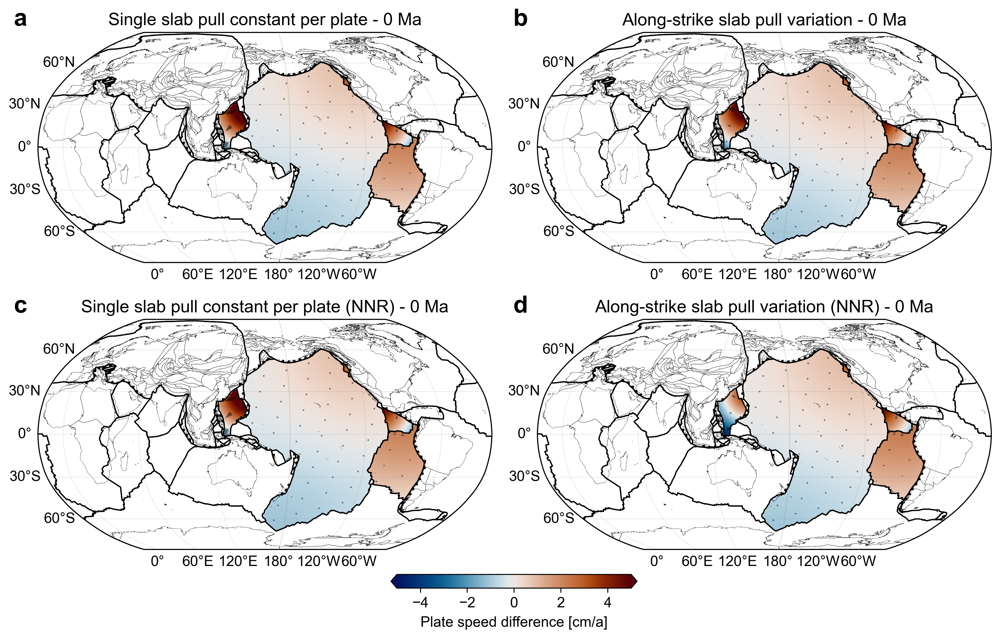

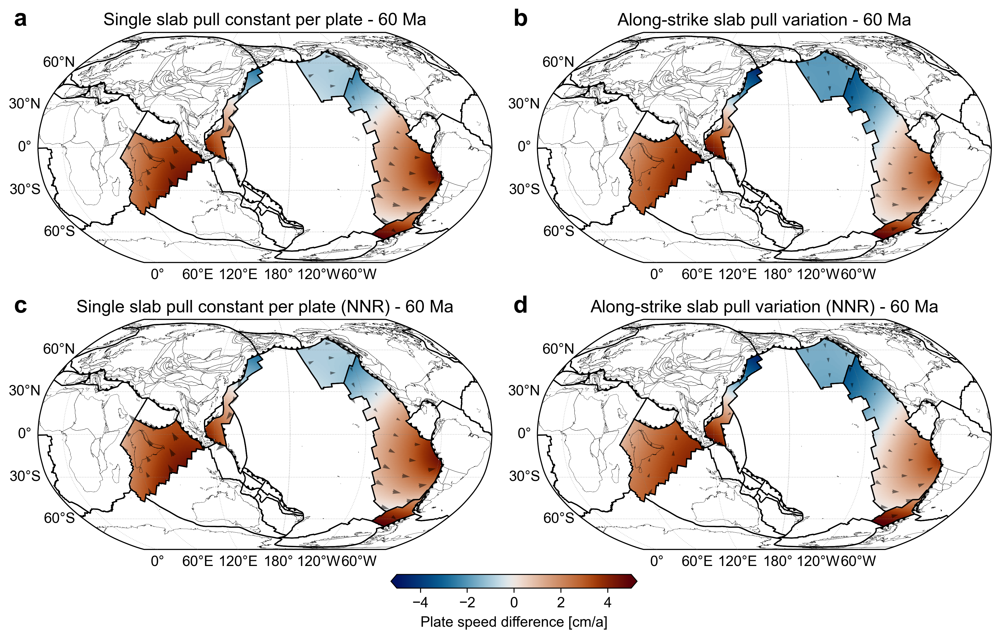

In [ ]:
if PLOT_FIGS:
    plot_ages = [0, 60]

    for plot_age in plot_ages:
        # Create a figure and gridspec
        fig = plt.figure(figsize=(fig_width, fig_height_maps), dpi=300)
        gs = gridspec.GridSpec(2, 2, wspace=0.1, hspace=0.2)

        plot_cases = ["opt1", "opt2", "opt1_nnr", "opt2_nnr"]

        plot_titles = ["Single slab pull constant per plate", "Along-strike slab pull variation", "Single slab pull constant per plate (NNR)", "Along-strike slab pull variation (NNR)"]
        
        # Plot slab pull constant along trenches for each case
        m = 0
        for i in range(2):
            for j in range(2):
                ax = plt.subplot(gs[i, j], projection=projection)
                ax.set_title(f"{plot_titles[m]} - {plot_age} Ma")
                if plot_age < 36:
                    vel_diffs = plot_M2016.plot_velocity_difference_map(ax, plot_age, f"syn_{plot_cases[m]}", "ref", plateIDs = plateIDs + [608, 901], vmin=-5, vmax=5)
                elif plot_age < 46:
                    vel_diffs = plot_M2016.plot_velocity_difference_map(ax, plot_age, f"syn_{plot_cases[m]}", "ref", plateIDs = plateIDs + [901], vmin=-5, vmax=5)
                elif plot_age < 56:
                    vel_diffs = plot_M2016.plot_velocity_difference_map(ax, plot_age, f"syn_{plot_cases[m]}", "ref", plateIDs = plateIDs + [501, 901], vmin=-5, vmax=5)
                else:
                    vel_diffs = plot_M2016.plot_velocity_difference_map(ax, plot_age, f"syn_{plot_cases[m]}", "ref", plateIDs = plateIDs + [501], vmin=-5, vmax=5)

                ax.annotate(annotations[m], xy=(-0.053, 1.03), xycoords="axes fraction", fontweight="bold")
                
                m += 1

        # Create a new grid for the colorbar
        cax2 = fig.add_axes([0.412, 0.06, 0.2, 0.02])

        # Create a colorbar below the subplots
        cbar2 = plt.colorbar(vel_diffs[0], cax=cax2, orientation="horizontal", extend="both", extendfrac=25e-3)

        # Set colorbar label
        cbar2.set_label("Plate speed difference [cm/a]", labelpad=5)

        fig.savefig(os.path.join(figs_dir, f"M2016_velocity_field_difference_{plot_age}Ma.png"), bbox_inches="tight")

        plt.show()

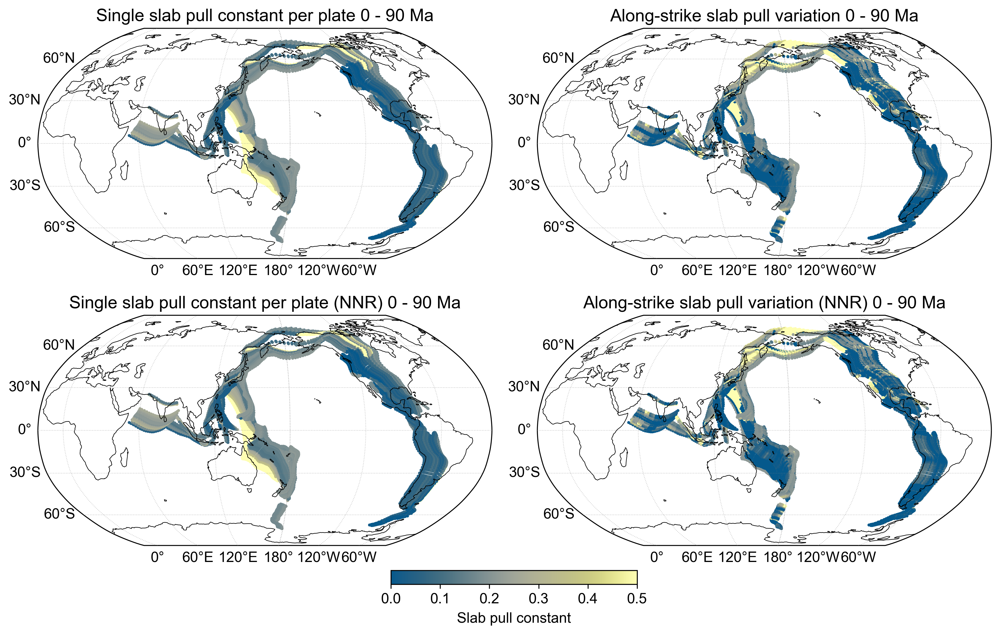

In [ ]:
if PLOT_FIGS:
    # Create a figure and gridspec
    fig = plt.figure(figsize=(fig_width, fig_height_maps), dpi=300)
    gs = gridspec.GridSpec(2, 2, wspace=0.1, hspace=0.2)

    plot_cases = ["opt1", "opt2", "opt1_nnr", "opt2_nnr"]

    plot_titles = ["Single slab pull constant per plate", "Along-strike slab pull variation", "Single slab pull constant per plate (NNR)", "Along-strike slab pull variation (NNR)"]

    # Plot slab pull constant along trenches for each case
    m = 0
    for i in range(2):
        for j in range(2):
            ax = plt.subplot(gs[i, j], projection=projection)
            plot_M2016.plot_basemap(ax)
            ax.coastlines(lw=0.5)
            ax.set_title(f"{plot_titles[m]} {M2016.ages[0]} - {M2016.ages[-1]} Ma")
            ax.set_global()
            for age in np.flip(M2016.ages):
                slab_data = M2016.slabs.data[age][plot_cases[m]]
                if age < 36:
                    slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [608, 901])]
                elif age < 46:
                    slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]
                elif age < 56:
                    slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501, 901])]
                else:
                    slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501])]

                sc = ax.scatter(
                        slab_data.lon,
                        slab_data.lat,
                        c = slab_data.slab_pull_constant,
                        s = 2,
                        vmin = 0,
                        vmax = .5,
                        cmap = "cmc.nuuk",
                        transform = ccrs.PlateCarree(),
                        # alpha=.5,
                    )
                
                # regions = []
                # regions.append(
                #     (, 10)
                # )

            m += 1

    # Create a new grid for the colorbar
    cax2 = fig.add_axes([0.412, 0.06, 0.2, 0.02])

    # Create a colorbar below the subplots
    cbar2 = plt.colorbar(sc, cax=cax2, orientation="horizontal")

    # Set colorbar label
    cbar2.set_label("Slab pull constant", labelpad=5)

    fig.savefig(os.path.join(figs_dir, f"M2016_optimised_slab_pull_constant_distribution.png"), bbox_inches="tight")


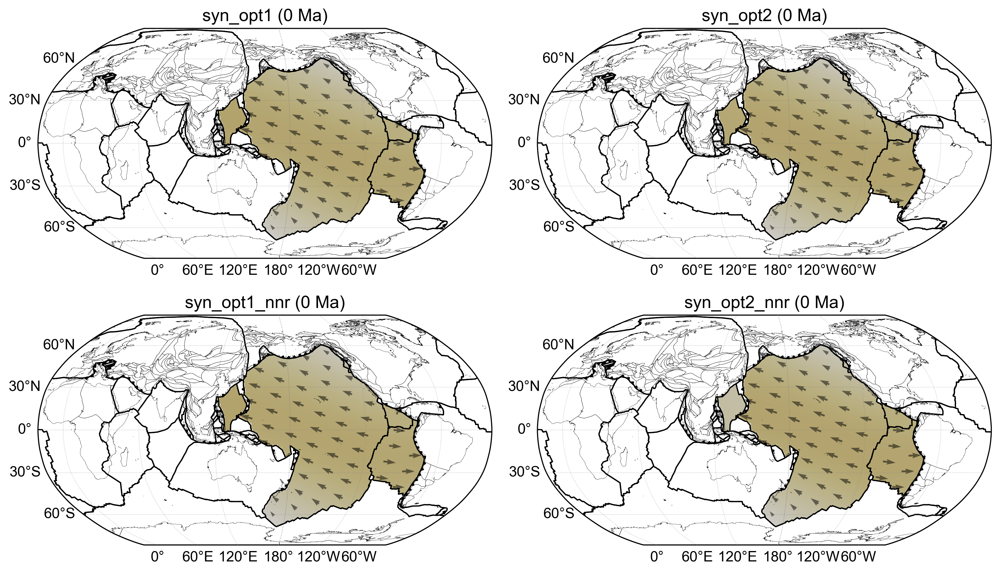

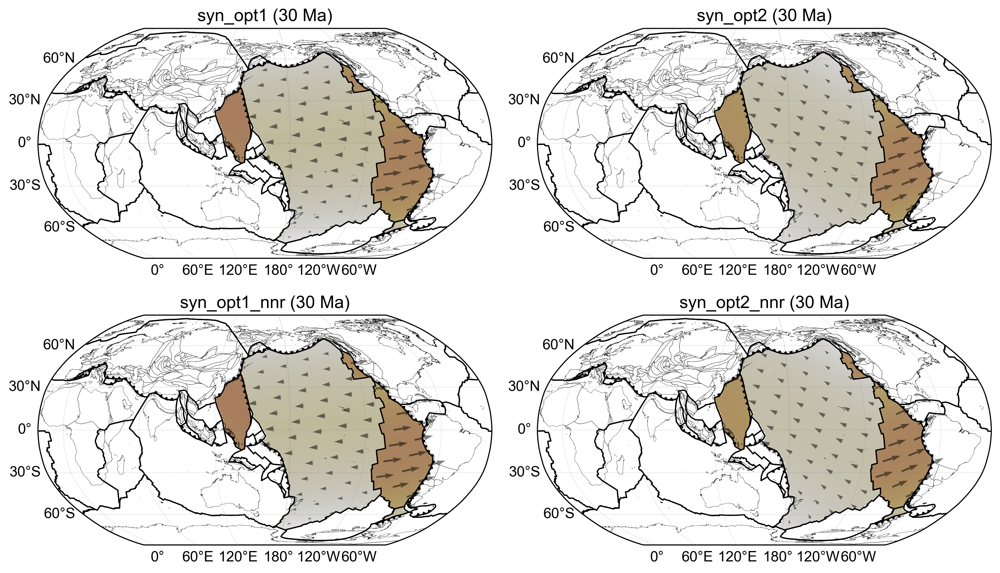

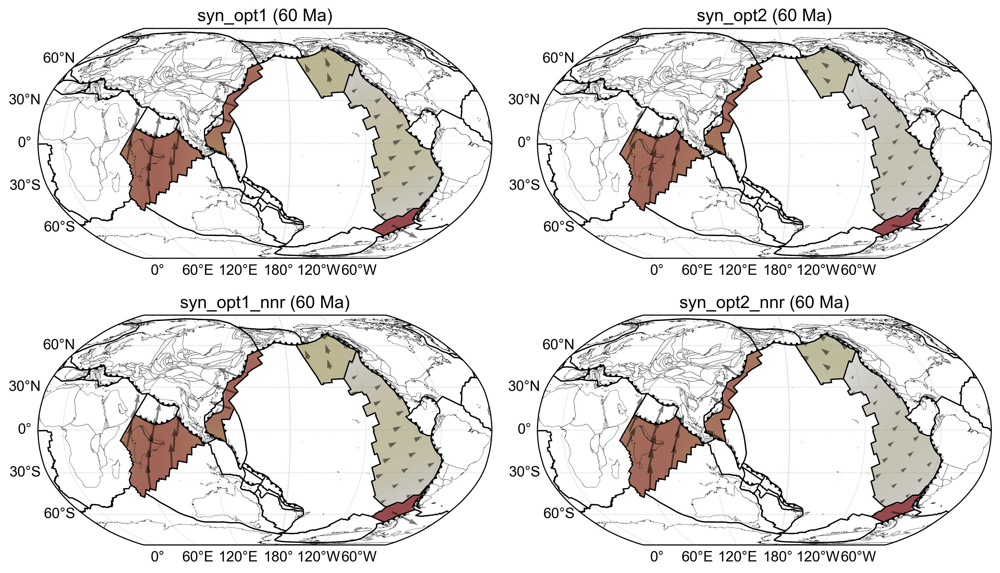

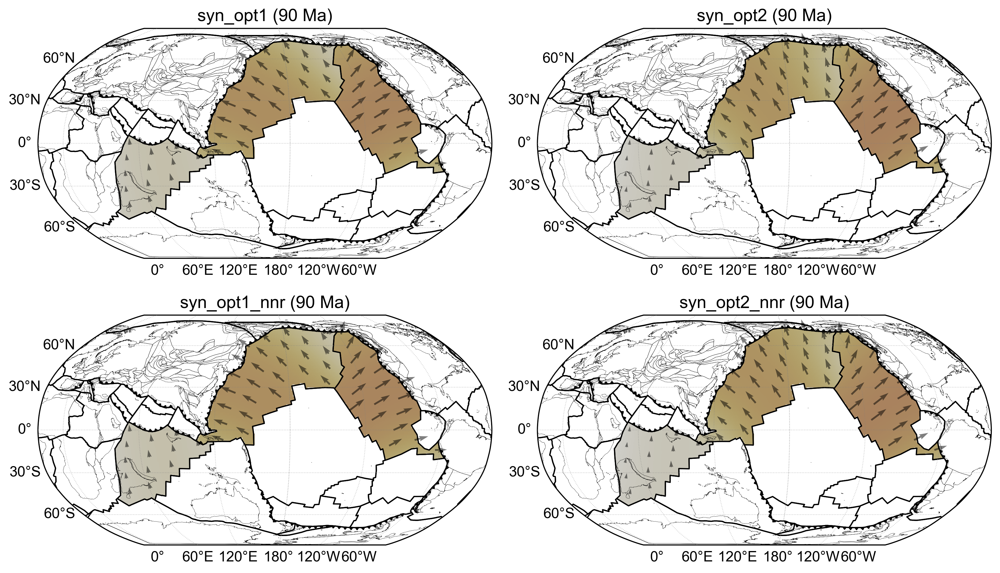

In [ ]:
if PLOT_FIGS:
    plot_ages = [0, 30, 60, 90]

    for plot_age in plot_ages:
        # Create a figure and gridspec
        fig = plt.figure(figsize=(fig_width, fig_height_maps), dpi=300)
        gs = gridspec.GridSpec(2, 2, wspace=0.1, hspace=0.2)

        plot_cases = ["syn_opt1", "syn_opt2", "syn_opt1_nnr", "syn_opt2_nnr"]
        
        # Plot slab pull constant along trenches for each case
        m = 0
        for i in range(2):
            for j in range(2):
                ax = plt.subplot(gs[i, j], projection=projection)
                ax.set_title(f"{plot_cases[m]} ({plot_age} Ma)")
                if plot_age < 46:
                    vels = plot_M2016.plot_velocity_map(ax, plot_age, plot_cases[m], plateIDs = plateIDs + [901])
                elif plot_age < 56:
                    vels = plot_M2016.plot_velocity_map(ax, plot_age, plot_cases[m], plateIDs = plateIDs + [501, 901])
                else:
                    vels = plot_M2016.plot_velocity_map(ax, plot_age, plot_cases[m], plateIDs = plateIDs + [501])

                m += 1

        plt.show()

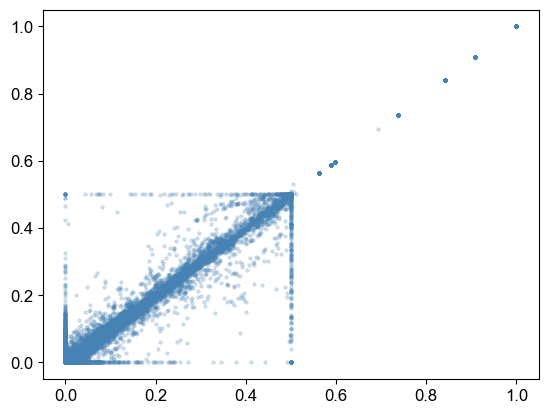

In [ ]:
for age in M2016.ages:
    for case in M2016.cases:
        if "nnr" in case:
            continue

        slab_data = M2016.slabs.data[age][case]; slab_data_nnr = M2016.slabs.data[age][f"{case}_nnr"]

        if age < 46:
            slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [901])]
        elif age < 56:
            slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501, 901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501, 901])]
        else:
            slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501])]

        plt.scatter(
            slab_data.slab_pull_constant,
            slab_data_nnr.slab_pull_constant,
            s = 5,
            c="steelblue",
            alpha=0.1
        )

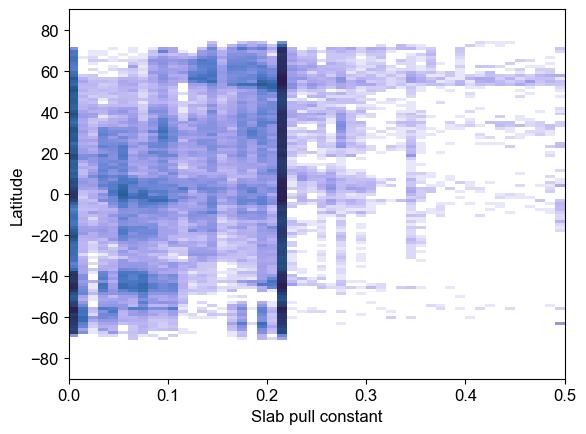

In [111]:
lats = []; sp_consts = []
for age in M2016.ages:
    for case in M2016.cases:
        if "nnr" in case:
            continue

        slab_data = M2016.slabs.data[age][case]; slab_data_nnr = M2016.slabs.data[age][f"{case}_nnr"]
        if age < 36:
            slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [608, 901])]
        elif age < 46:
            slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]#; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [901])]
        elif age < 56:
            slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501, 901])]#; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501, 901])]
        else:
            slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501])]#; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501])]
        
        # Drop rows where either lat or slab_pull_constant is NaN
        slab_data = slab_data.dropna(subset=["lat", "slab_pull_constant"])

        # Store values in synchronized lists
        lats.extend(slab_data.lat.values)
        sp_consts.extend(slab_data.slab_pull_constant.values)

fig, ax = plt.subplots()
hist = ax.hist2d(sp_consts, lats, bins=100, cmap="cmc.devon_r", norm=mcolors.LogNorm())  # Log scale normalizationax.set_ylabel("Latitude")
ax.set_xlabel("Slab pull constant")
ax.set_ylabel("Latitude")
ax.set_ylim(-90, 90)
ax.set_xlim(0, 0.5)

plt.show()

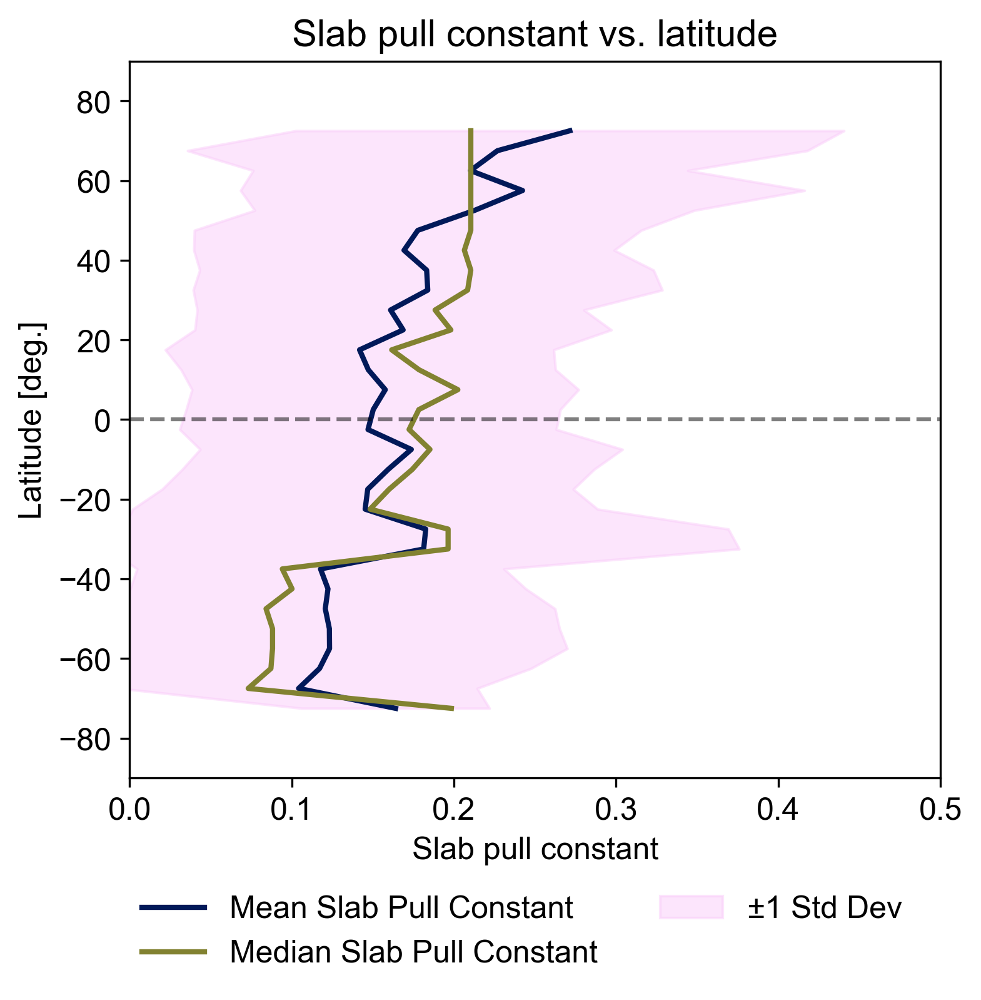

In [170]:
# Define latitude bins (e.g., every 5° from -90° to 90°)
lat_bins = np.arange(-90, 95, 5)  # Bins go slightly beyond 90 to include the last edge
lat_centers = (lat_bins[:-1] + lat_bins[1:]) / 2  # Compute bin centers

# Digitize latitudes to find which bin they belong to
lat_indices = np.digitize(lats, lat_bins) - 1  # Get bin indices

# Initialize arrays to store mean and std dev
mean_sp_consts = np.full(len(lat_centers), np.nan)
median_sp_consts = np.full(len(lat_centers), np.nan)
std_sp_consts = np.full(len(lat_centers), np.nan)

# Compute mean and std dev for each latitude bin
for i in range(len(lat_centers)):
    bin_mask = lat_indices == i
    if np.any(bin_mask):  # If there are values in the bin
        mean_sp_consts[i] = np.mean(np.array(sp_consts)[bin_mask])
        median_sp_consts[i] = np.median(np.array(sp_consts)[bin_mask])
        std_sp_consts[i] = np.std(np.array(sp_consts)[bin_mask])

# Plot mean slab pull constant per latitude bin with std deviation
fig, ax = plt.subplots(figsize=(fig_width*cm2in, fig_height_graphs*cm2in*2), dpi=300)

ax.plot(mean_sp_consts, lat_centers, label="Mean Slab Pull Constant", color=plate_colours[0], linewidth=2)
ax.plot(median_sp_consts, lat_centers, label="Median Slab Pull Constant", color=plate_colours[1], linewidth=2)
ax.fill_betweenx(lat_centers, mean_sp_consts - std_sp_consts, mean_sp_consts + std_sp_consts, 
                 color=plate_colours[-1], alpha=0.5, label="±1 Std Dev")

# Labels and limits
ax.set_xlabel("Slab pull constant")
ax.set_ylabel("Latitude [deg.]")
ax.set_xlim(0, 0.5)
ax.set_ylim(-90, 90)
ax.set_title("Slab pull constant vs. latitude")

# Reference lines
ax.axhline(0, linestyle="--", color="k", alpha=0.5)

# Add a legend below the entire figure
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc="lower center", ncol=2, frameon=False, bbox_to_anchor=(0.5, -0.125))


fig.savefig(os.path.join(figs_dir, "Slab_pull_constant_vs_latitude.png"), bbox_inches="tight")

In [ ]:
def get_geometric_properties(
        plates: pd.DataFrame,
        slabs: pd.DataFrame,
    ):
    """
    Function to get geometric properties of plates.

    :param plates:                plates
    :type plates:                 pandas.DataFrame
    :param slabs:                 slabs
    :type slabs:                  pandas.DataFrame

    :return:                      plates
    :rtype:                       pandas.DataFrame
    """
    # Calculate trench length and omega
    for plateID in plates.plateID:
        if plateID in slabs.lower_plateID.unique():
            plates.loc[plates.plateID == plateID, "trench_length"] = slabs[slabs.lower_plateID == plateID].trench_segment_length.sum()
            plates.loc[plates.plateID == plateID, "zeta"] = plates[plates.plateID == plateID].area.values[0] / plates[plates.plateID == plateID].trench_length.values[0]

    return plates

In [ ]:
for age in M2016.ages:
    for case in M2016.cases:
        M2016.plates.data[age][case] = get_geometric_properties(M2016.plates.data[age][case], M2016.slabs.data[age][case])

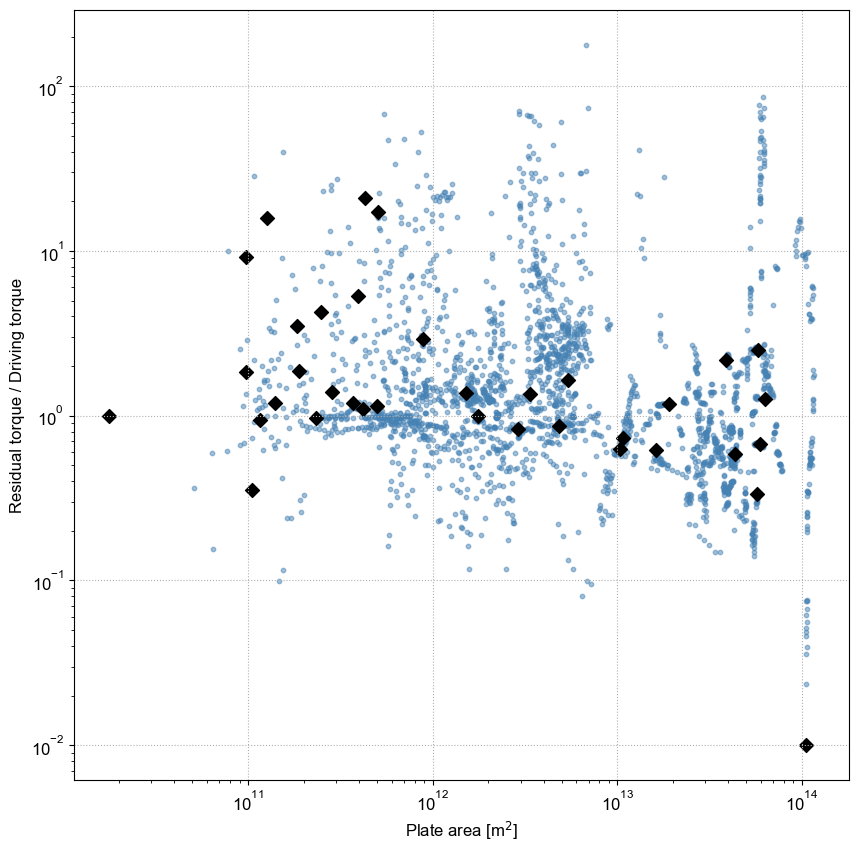

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
for age in np.flip(M2016.ages):
    if age == 0:
        color = "k"
        marker = "D"
        alpha = 1
        size = 50
    else:
        color = "steelblue"
        marker = "o"
        alpha = 0.5
        size = 10

    plt.scatter(
        M2016.plates.data[age]["ref"].area,
        M2016.plates.data[age]["ref"].residual_torque_mag/M2016.plates.data[age]["ref"].driving_torque_mag,
        s = size,
        c = color,
        marker = marker,
        alpha = alpha
    )

plt.xscale("log"); plt.yscale("log")
plt.xlabel(r"Plate area [m$^2$]"); plt.ylabel("Residual torque / Driving torque")
plt.grid(ls=":")

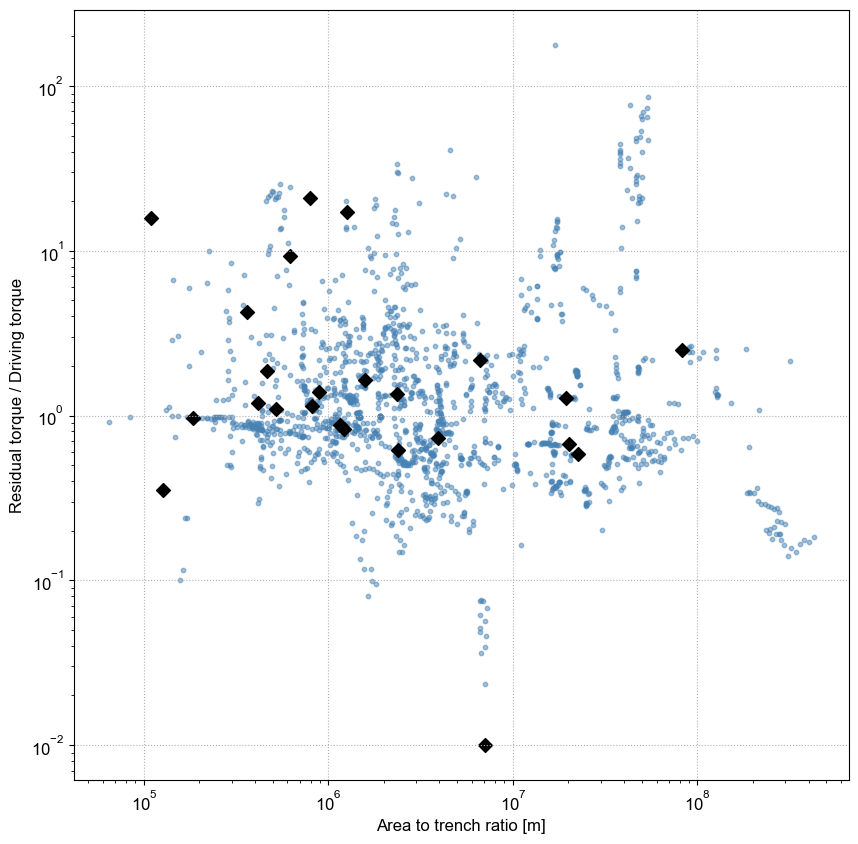

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))

for age in np.flip(M2016.ages):
    if age == 0:
        color = "k"
        marker = "D"
        alpha = 1
        size = 50
    else:
        color = "steelblue"
        marker = "o"
        alpha = 0.5
        size = 10

    plt.scatter(
        M2016.plates.data[age]["ref"].zeta,
        M2016.plates.data[age]["ref"].residual_torque_mag/M2016.plates.data[age]["ref"].driving_torque_mag,
        s = size,
        c = color,
        marker = marker,
        alpha = alpha
    )

plt.xscale("log"); plt.yscale("log")
plt.xlabel("Area to trench ratio [m]"); plt.ylabel("Residual torque / Driving torque")
plt.grid(ls=":")

NameError: name 'sp_consts' is not defined

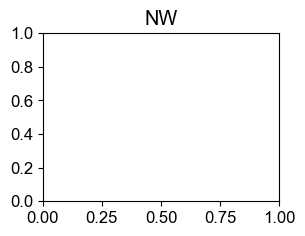

In [ ]:
m = 0
for i in range(2):
    for j in range(2):
        ax = plt.subplot(gs[i, j])
        ax.set_title(["NW", "NE", "SW", "SE"][m])

        # Collect all data points for this region
        ages = []
        values = []
        weights = []
        for age in M2016.ages:
            ages.extend([age] * len(sp_consts[m][age]))  # Repeat age for each value
            values.extend(sp_consts[m][age])  # Slab pull constant values
            weights.extend(trench_lengths[m][age])  # Corresponding trench segment lengths

        # Convert to numpy arrays
        ages = np.array(ages)
        values = np.array(values)
        weights = np.array(weights)

        # Plot using hist2d (2D histogram), weighted by trench segment length
        ax.scatter(ages, values, s=0.01, c="steelblue", alpha=0.5)

        ax.set_ylim(0, 0.5)
        ax.set_xlim(0, 90)

        ax.set_xticks(np.arange(0, 90+1, 10))

        ax.set_xticklabels([]) if i == 0 else None
        ax.set_yticklabels([]) if j == 1 else None

        ax.set_xlabel("Age [Ma]") if i == 1 else None
        ax.set_ylabel("Slab pull constant") if j == 0 else None

        ax.annotate(annotations[m], xy=(0, 1.03), xycoords="axes fraction", fontweight="bold")        

        m += 1

In [ ]:
slab_data.columns

Index(['index', 'lon', 'lat', 'trench_segment_length', 'trench_normal_azimuth',
       'lower_plateID', 'trench_plateID', 'slab_sampling_lat',
       'slab_sampling_lon', 'arc_sampling_lat', 'arc_sampling_lon',
       'upper_plateID', 'upper_plate_velocity_lat', 'upper_plate_velocity_lon',
       'upper_plate_velocity_mag', 'lower_plate_velocity_lat',
       'lower_plate_velocity_lon', 'lower_plate_velocity_mag',
       'trench_velocity_lat', 'trench_velocity_lon', 'trench_velocity_mag',
       'convergence_velocity_lat', 'convergence_velocity_lon',
       'convergence_velocity_mag', 'arc_thickness', 'arc_seafloor_age',
       'continental_arc', 'erosion_rate', 'slab_seafloor_age',
       'slab_lithospheric_thickness', 'slab_crustal_thickness',
       'slab_water_depth', 'shear_zone_width', 'sediment_thickness',
       'sediment_fraction', 'slab_length', 'slab_pull_force_mag',
       'slab_pull_force_lat', 'slab_pull_force_lon', 'slab_bend_force_mag',
       'slab_bend_force_lat', 'sla

In [ ]:
sp_consts_SW = {}; sp_consts_NW = {}; sp_consts_NE = {}; sp_consts_SE = {}
trench_lengths_SW = {}; trench_lengths_NW = {}; trench_lengths_NE = {}; trench_lengths_SE = {}
slab_flux_SW = {}; slab_flux_NW = {}; slab_flux_NE = {}; slab_flux_SE = {}
lat_SW = {}; lat_NW = {}; lat_NE = {}; lat_SE = {}
lon_SW = {}; lon_NW = {}; lon_NE = {}; lon_SE = {}

for age in M2016.ages:
    sp_consts_SW[age] = []; sp_consts_NW[age] = []; sp_consts_NE[age] = []; sp_consts_SE[age] = []
    trench_lengths_SW[age] = []; trench_lengths_NW[age] = []; trench_lengths_NE[age] = []; trench_lengths_SE[age] = []
    slab_flux_SW[age] = []; slab_flux_NW[age] = []; slab_flux_NE[age] = []; slab_flux_SE[age] = []
    lat_SW[age] = []; lat_NW[age] = []; lat_NE[age] = []; lat_SE[age] = []
    lon_SW[age] = []; lon_NW[age] = []; lon_NE[age] = []; lon_SE[age] = []

    # Select data
    slab_data = M2016.slabs.data[age]["opt2"]

    if age < 36:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [608, 901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [608, 901])]
    elif age < 46:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [901])]
    elif age < 56:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501, 901])]
    else:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs)]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501])]

    # Subsample for each region
    sp_consts_SW[age].extend(np.nan_to_num(slab_data[(slab_data.lon > 0) & (slab_data.lat < 0)].slab_pull_constant.values))
    sp_consts_NW[age].extend(np.nan_to_num(slab_data[(slab_data.lon > 0) & (slab_data.lat > 0)].slab_pull_constant.values))
    sp_consts_NE[age].extend(np.nan_to_num(slab_data[(slab_data.lon < 0) & (slab_data.lat > 0)].slab_pull_constant.values))
    sp_consts_SE[age].extend(np.nan_to_num(slab_data[(slab_data.lon < 0) & (slab_data.lat < 0)].slab_pull_constant.values))

    trench_lengths_SW[age].extend(np.nan_to_num(slab_data[(slab_data.lon > 0) & (slab_data.lat < 0)].trench_segment_length.values))
    trench_lengths_NW[age].extend(np.nan_to_num(slab_data[(slab_data.lon > 0) & (slab_data.lat > 0)].trench_segment_length.values))
    trench_lengths_NE[age].extend(np.nan_to_num(slab_data[(slab_data.lon < 0) & (slab_data.lat > 0)].trench_segment_length.values))
    trench_lengths_SE[age].extend(np.nan_to_num(slab_data[(slab_data.lon < 0) & (slab_data.lat < 0)].trench_segment_length.values))

    slab_flux = (slab_data.slab_lithospheric_thickness + slab_data.slab_crustal_thickness) * slab_data.convergence_velocity_mag * slab_data.trench_segment_length

    slab_flux_SW[age].extend(np.nan_to_num(slab_flux[(slab_data.lon > 0) & (slab_data.lat < 0)].values))
    slab_flux_NW[age].extend(np.nan_to_num(slab_flux[(slab_data.lon > 0) & (slab_data.lat > 0)].values))
    slab_flux_NE[age].extend(np.nan_to_num(slab_flux[(slab_data.lon < 0) & (slab_data.lat > 0)].values))
    slab_flux_SE[age].extend(np.nan_to_num(slab_flux[(slab_data.lon < 0) & (slab_data.lat < 0)].values))

    lat_SW[age].extend(np.nan_to_num(slab_data[(slab_data.lon > 0) & (slab_data.lat < 0)].lat.values))
    lat_NW[age].extend(np.nan_to_num(slab_data[(slab_data.lon > 0) & (slab_data.lat > 0)].lat.values))
    lat_NE[age].extend(np.nan_to_num(slab_data[(slab_data.lon < 0) & (slab_data.lat > 0)].lat.values))
    lat_SE[age].extend(np.nan_to_num(slab_data[(slab_data.lon < 0) & (slab_data.lat < 0)].lat.values))

    lon_SW[age].extend(np.nan_to_num(slab_data[(slab_data.lon > 0) & (slab_data.lat < 0)].lon.values))
    lon_NW[age].extend(np.nan_to_num(slab_data[(slab_data.lon > 0) & (slab_data.lat > 0)].lon.values))
    lon_NE[age].extend(np.nan_to_num(slab_data[(slab_data.lon < 0) & (slab_data.lat > 0)].lon.values))
    lon_SE[age].extend(np.nan_to_num(slab_data[(slab_data.lon < 0) & (slab_data.lat < 0)].lon.values))

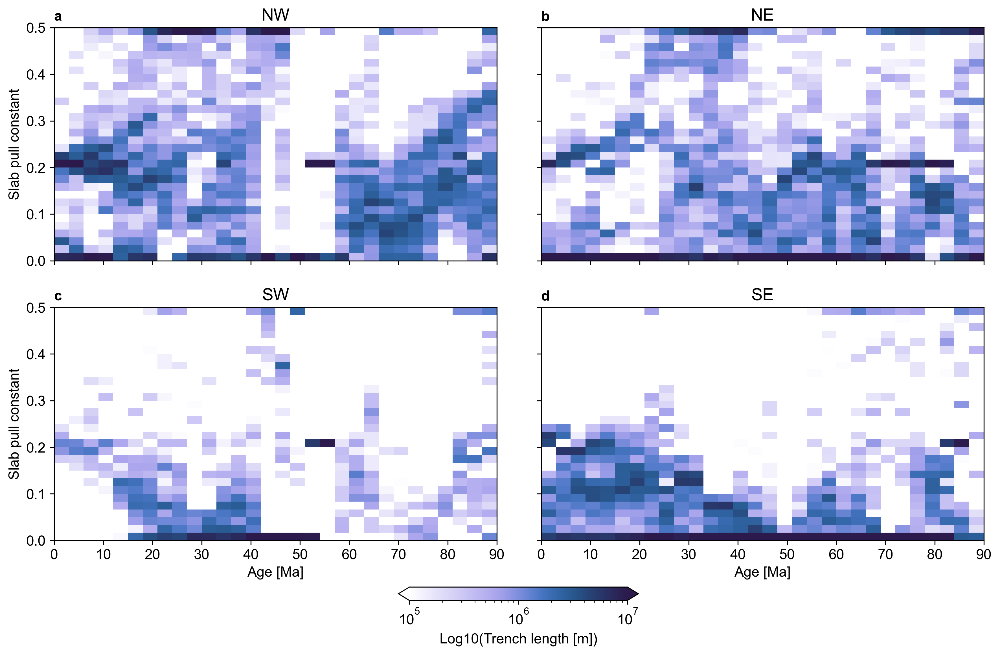

In [ ]:
# Create a figure and gridspec
fig = plt.figure(figsize=(fig_width, fig_height_maps), dpi=300)
gs = gridspec.GridSpec(2, 2, width_ratios=[1, 1], height_ratios=[1, 1], wspace=0.1, hspace=0.2)

sp_consts = [sp_consts_NW, sp_consts_NE, sp_consts_SW, sp_consts_SE]
trench_lengths = [trench_lengths_NW, trench_lengths_NE, trench_lengths_SW, trench_lengths_SE]
m = 0
for i in range(2):
    for j in range(2):
        ax = plt.subplot(gs[i, j])
        ax.set_title(["NW", "NE", "SW", "SE"][m])

        # Collect all data points for this region
        ages = []
        values = []
        weights = []
        for age in M2016.ages:
            ages.extend([age] * len(sp_consts[m][age]))  # Repeat age for each value
            values.extend(sp_consts[m][age])  # Slab pull constant values
            weights.extend(trench_lengths[m][age])  # Corresponding trench segment lengths

        # Convert to numpy arrays
        ages = np.array(ages)
        values = np.array(values)
        weights = np.array(weights)

        # Plot using hist2d (2D histogram), weighted by trench segment length
        h = ax.hist2d(ages, values, bins=[30, 30], cmap="cmc.devon_r", range=[[0, 90], [0, 0.5]], 
              weights=weights, norm=mcolors.LogNorm(vmin=1e5, vmax=1e7))

        ax.set_ylim(0, 0.5)
        ax.set_xlim(0, 90)

        ax.set_xticks(np.arange(0, 90+1, 10))

        ax.set_xticklabels([]) if i == 0 else None
        ax.set_yticklabels([]) if j == 1 else None

        ax.set_xlabel("Age [Ma]") if i == 1 else None
        ax.set_ylabel("Slab pull constant") if j == 0 else None

        ax.annotate(annotations[m], xy=(0, 1.03), xycoords="axes fraction", fontweight="bold")        

        m += 1

# Create a new grid for the colorbar
cax2 = fig.add_axes([0.412, 0.02, 0.2, 0.02])

# Create a colorbar below the subplots
cbar2 = plt.colorbar(h[3], cax=cax2, orientation="horizontal", extend="both")

# Set colorbar label
cbar2.set_label("Log10(Trench length [m])", labelpad=5)

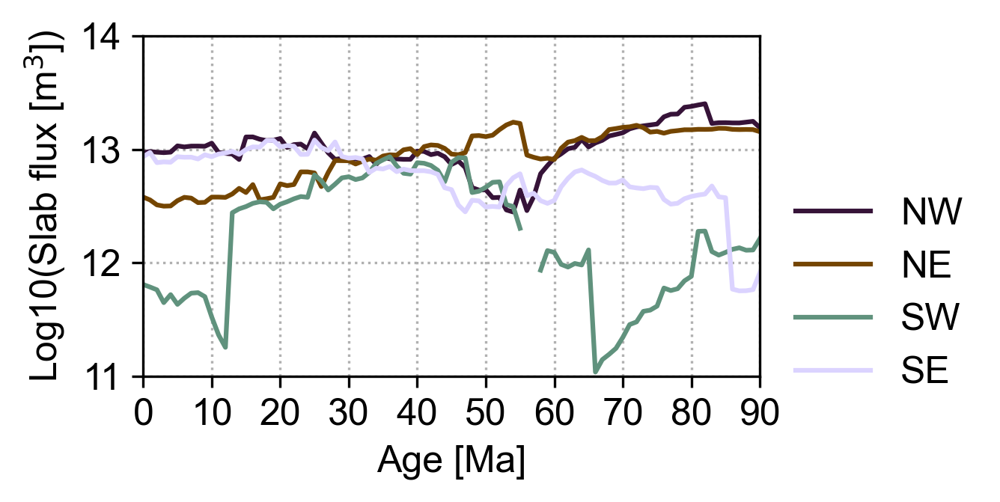

In [ ]:
regions_colours = plt.get_cmap("cmc.glasgow")(np.linspace(0, 1, 4))
slab_fluxes = [slab_flux_NW, slab_flux_NE, slab_flux_SW, slab_flux_SE]

fig, ax = plt.subplots(figsize=(fig_width/4, fig_height_maps/4), dpi=300)
for m in range(4):
    flux = []
    for age in M2016.ages:
        flux.append(np.nansum(slab_fluxes[m][age]))

    ax.plot(np.log10(flux), c=regions_colours[m], label = ["NW", "NE", "SW", "SE"][m])
ax.grid(ls=":")
ax.set_ylim(11, 14)
ax.set_xlim(0, 90)
ax.set_xticks(np.arange(0, 90+1, 10))
ax.set_xlabel("Age [Ma]")
ax.set_ylabel(r"Log10(Slab flux [m$^3$])")
fig.legend(loc="lower center", ncol=1, frameon=False, bbox_to_anchor=(1.05, 0))

plt.show()

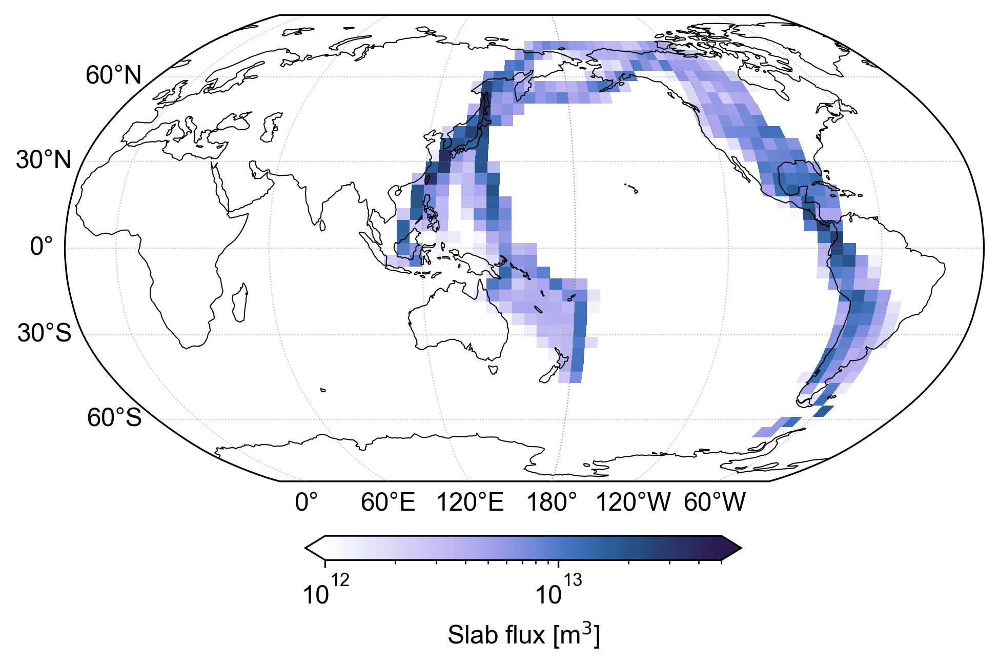

In [ ]:
# Create a figure and gridspec
fig, plt.figure(figsize=(fig_width, fig_height_maps/2), dpi=300)
gs = gridspec.GridSpec(1, 2, wspace=0.1, hspace=0.2)

ax1 = plt.subplot(gs[0], projection=projection); ax2 = plt.subplot(gs[1], projection=projection)
lats = []; lons = []; fluxes = []
for age in M2016.ages:
    # Select data
    slab_data = M2016.slabs.data[age]["opt2"]

    if age < 36:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [608, 901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [608, 901])]
    elif age < 46:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [901])]
    elif age < 56:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501, 901])]
    else:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs)]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501])]

    slab_flux = (slab_data.slab_lithospheric_thickness + slab_data.slab_crustal_thickness) * slab_data.convergence_velocity_mag * slab_data.trench_segment_length
    mean_sp_const = np.nanmean(slab_data.slab_pull_constant.values)

    # Append values
    lats.extend(slab_data.lat.values); lons.extend(slab_data.lon.values); fluxes.extend(slab_flux)

h = ax1.hist2d(lons, lats, bins=[72, 36], cmap="cmc.devon_r",# range=[[-180, 180], [-90, 90]], 
          weights=fluxes, transform=ccrs.PlateCarree(), norm=mcolors.LogNorm(vmin=1e12, vmax=5e13))

h = ax2.imshow(np.array())



for ax in [ax1, ax2]:
    plot_M2016.plot_basemap(ax)
    ax.coastlines(lw=0.5)
    ax.set_global()

# Create a new grid for the colorbar
cax2 = fig.add_axes([0.412, -0.02, 0.2, 0.04])

# Create a colorbar below the subplots
cbar2 = plt.colorbar(h[3], cax=cax2, orientation="horizontal", extend="both")

# Set colorbar label
cbar2.set_label(r"Slab flux [m$^3$]", labelpad=5)

In [ ]:
from scipy.signal import correlate

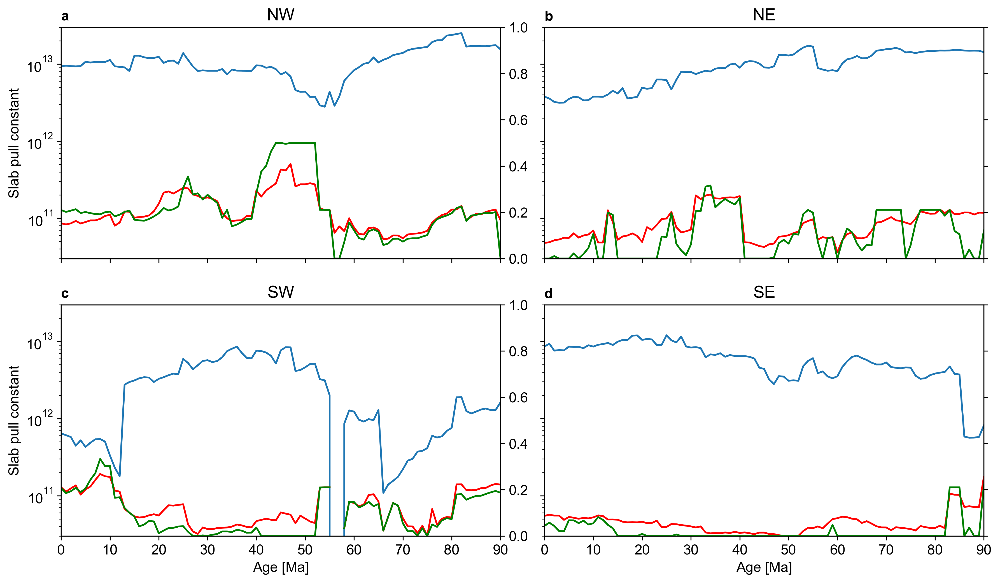

In [ ]:
# Create a figure and gridspec
fig = plt.figure(figsize=(fig_width, fig_height_maps), dpi=300)
gs = gridspec.GridSpec(2, 2, width_ratios=[1, 1], height_ratios=[1, 1], wspace=0.1, hspace=0.2)

slab_fluxes = [slab_flux_NW, slab_flux_NE, slab_flux_SW, slab_flux_SE]
sp_consts = [sp_consts_NW, sp_consts_NE, sp_consts_SW, sp_consts_SE]
trench_lengths = [trench_lengths_NW, trench_lengths_NE, trench_lengths_SW, trench_lengths_SE]
m = 0
for i in range(2):
    for j in range(2):
        ax1 = plt.subplot(gs[i, j])
        ax1.set_title(["NW", "NE", "SW", "SE"][m])

        flux = []; mean_sp_const = []; median_sp_const = []
        for age in M2016.ages:
            flux.append(np.nansum(slab_fluxes[m][age]))
            mean_sp_const.append(np.nanmean(sp_consts[m][age]))
            median_sp_const.append(np.nanmedian(sp_consts[m][age]))
        
        # flux = np.where(np.array(flux) == 0, np.nan, flux)
    
        ax1.plot(flux)
        ax2 = ax1.twinx()
        ax2.plot(mean_sp_const, c="r")
        ax2.plot(median_sp_const, c="g")

        ax1.set_ylim(3e10, 3e13)
        ax2.set_ylim(0, 1)
        ax1.set_yscale("log")
        ax1.set_xlim(0, 90)

        ax1.set_xticks(np.arange(0, 90+1, 10))

        for ax in [ax1, ax2]:
            ax.set_xticklabels([]) if i == 0 else None
            ax.set_yticklabels([]) if j == 1 else None

        ax1.set_xlabel("Age [Ma]") if i == 1 else None
        ax1.set_ylabel("Slab pull constant") if j == 0 else None

        ax1.annotate(annotations[m], xy=(0, 1.03), xycoords="axes fraction", fontweight="bold")        

        m += 1

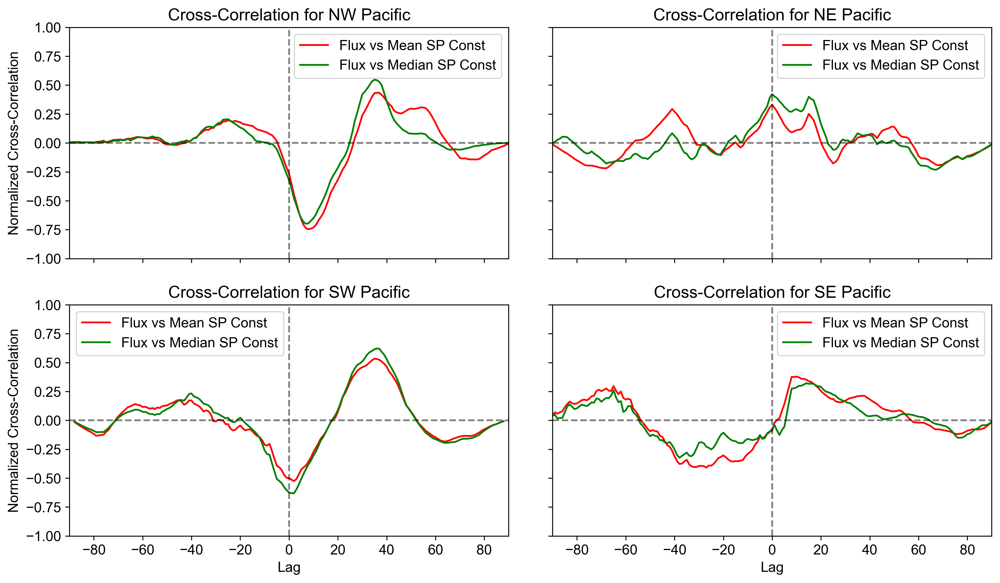

In [ ]:
# Create figure and gridspec
fig = plt.figure(figsize=(fig_width, fig_height_maps), dpi=300)
gs = gridspec.GridSpec(2, 2, width_ratios=[1, 1], height_ratios=[1, 1], wspace=0.1, hspace=0.2)

slab_fluxes = [slab_flux_NW, slab_flux_NE, slab_flux_SW, slab_flux_SE]
sp_consts = [sp_consts_NW, sp_consts_NE, sp_consts_SW, sp_consts_SE]
trench_lengths = [trench_lengths_NW, trench_lengths_NE, trench_lengths_SW, trench_lengths_SE]

m = 0
for i in range(2):
    for j in range(2):
        ax1 = plt.subplot(gs[i, j])
        ax1.set_title(f"Cross-Correlation for {['NW', 'NE', 'SW', 'SE'][m]} Pacific")

        flux = []
        mean_sp_const = []
        median_sp_const = []
        
        for age in M2016.ages:
            flux.append(np.nansum(slab_fluxes[m][age]))
            mean_sp_const.append(np.nanmean(sp_consts[m][age]))
            median_sp_const.append(np.nanmedian(sp_consts[m][age]))

        flux = np.array(flux)
        mean_sp_const = np.array(mean_sp_const)
        median_sp_const = np.array(median_sp_const)

        # Remove NaNs
        valid_indices = ~np.isnan(flux) & ~np.isnan(mean_sp_const) & ~np.isnan(median_sp_const)
        flux = flux[valid_indices]
        mean_sp_const = mean_sp_const[valid_indices]
        median_sp_const = median_sp_const[valid_indices]

        # Compute raw cross-correlation
        corr_mean = correlate(flux - np.mean(flux), mean_sp_const - np.mean(mean_sp_const), mode="full")
        corr_median = correlate(flux - np.mean(flux), median_sp_const - np.mean(median_sp_const), mode="full")

        # Compute normalization factor (standard deviations)
        norm_factor_mean = np.std(flux) * np.std(mean_sp_const) * len(flux)
        norm_factor_median = np.std(flux) * np.std(median_sp_const) * len(flux)

        # Normalize to range [-1, 1]
        corr_mean /= norm_factor_mean
        corr_median /= norm_factor_median

        # Lag values
        lags = np.arange(-len(flux) + 1, len(flux))

        # Plot normalized cross-correlation
        ax1.plot(lags, corr_mean, label="Flux vs Mean SP Const", color="r")
        ax1.plot(lags, corr_median, label="Flux vs Median SP Const", color="g")
        ax1.axvline(0, linestyle="--", color="k", alpha=0.5)
        ax1.axhline(0, linestyle="--", color="k", alpha=0.5)
        ax1.set_xlabel("Lag") if i == 1 else None
        ax1.set_ylabel("Normalized Cross-Correlation") if j == 0 else None
        ax1.set_xticklabels([]) if i == 0 else None
        ax1.set_yticklabels([]) if j == 1 else None
        ax1.set_ylim(-1, 1)
        ax1.set_xlim(-90, 90)
        ax1.legend()
        
        m += 1

plt.show()


In [164]:
# Define grid resolution
lat_bins = np.arange(0, 90 + 2, 2)  # Latitude bins (every 2 degrees)
lon_bins = np.arange(-180, 180 + 2, 2)  # Longitude bins (every 2 degrees)

# Initialize storage arrays
grid_flux = {age: np.zeros((len(lat_bins)-1, len(lon_bins)-1)) for age in M2016.ages}
grid_pull = {age: np.zeros((len(lat_bins)-1, len(lon_bins)-1)) for age in M2016.ages}
grid_counts = {age: np.zeros((len(lat_bins)-1, len(lon_bins)-1)) for age in M2016.ages}

# Loop through ages and compute mean slab flux and slab pull constant per grid cell
for age in M2016.ages:
    slab_data = M2016.slabs.data[age]["opt2"]

    # Apply plate filtering conditions
    if age < 36:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [608, 901])]
    elif age < 46:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]
    elif age < 56:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501, 901])]
    else:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501])]

    # Calculate slab flux and slab pull constant
    slab_flux = (slab_data.slab_lithospheric_thickness + slab_data.slab_crustal_thickness) * slab_data.convergence_velocity_mag * slab_data.trench_segment_length
    slab_pull = slab_data.slab_pull_constant  # Assuming "slab_pull_constant" is available in the dataset

    # Bin the data into 2x2 degree grid
    lat_idx = np.digitize(slab_data.lat.values, lat_bins) - 1
    lon_idx = np.digitize(slab_data.lon.values, lon_bins) - 1

    for i in range(len(slab_data)):
        if 0 <= lat_idx[i] < len(lat_bins)-1 and 0 <= lon_idx[i] < len(lon_bins)-1:
            grid_flux[age][lat_idx[i], lon_idx[i]] += slab_flux.iloc[i]
            grid_pull[age][lat_idx[i], lon_idx[i]] += slab_pull.iloc[i]
            grid_counts[age][lat_idx[i], lon_idx[i]] += 1

# Compute mean values
for age in M2016.ages:
    grid_flux[age] /= np.where(grid_counts[age] > 0, grid_counts[age], np.nan)
    grid_pull[age] /= np.where(grid_counts[age] > 0, grid_counts[age], np.nan)

h = ax1.hist2d(lons, lats, bins=[72, 36], cmap="cmc.devon_r",# range=[[-180, 180], [-90, 90]], 
          weights=fluxes, transform=ccrs.PlateCarree(), norm=mcolors.LogNorm(vmin=1e12, vmax=5e13))

h = ax2.imshow(np.array())

for ax in [ax1, ax2]:
    plot_M2016.plot_basemap(ax)
    ax.coastlines(lw=0.5)
    ax.set_global()

# Create a new grid for the colorbar
cax2 = fig.add_axes([0.412, -0.02, 0.2, 0.04])

# Create a colorbar below the subplots
cbar2 = plt.colorbar(h[3], cax=cax2, orientation="horizontal", extend="both")

# Set colorbar label
cbar2.set_label(r"Slab flux [m$^3$]", labelpad=5)

NameError: name 'lons' is not defined

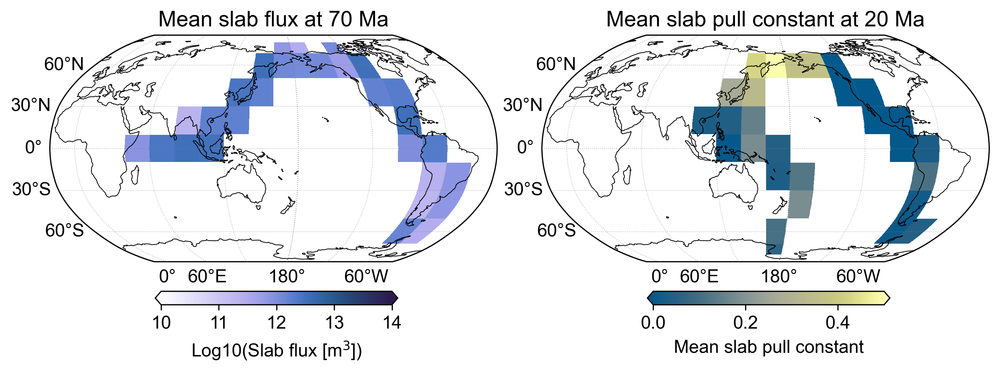

In [169]:
# Define grid resolution
spacing = 20
lat_bins = np.arange(-90, 90 + spacing, spacing)  # Latitude bins (every 2 degrees)
lon_bins = np.arange(-180, 180 + spacing, spacing)  # Longitude bins (every 2 degrees)

# Initialize storage arrays
grid_flux = {age: np.zeros((len(lat_bins)-1, len(lon_bins)-1)) for age in M2016.ages}
grid_pull = {age: np.zeros((len(lat_bins)-1, len(lon_bins)-1)) for age in M2016.ages}
grid_counts = {age: np.zeros((len(lat_bins)-1, len(lon_bins)-1)) for age in M2016.ages}

# Loop through ages and compute mean slab flux and slab pull constant per grid cell
for age in M2016.ages:
    slab_data = M2016.slabs.data[age]["opt2"]

    # Apply plate filtering conditions
    if age < 36:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [608, 901])]
    elif age < 46:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]
    elif age < 56:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501, 901])]
    else:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [501])]

    # Calculate slab flux and slab pull constant
    slab_flux = (slab_data.slab_lithospheric_thickness + slab_data.slab_crustal_thickness) * slab_data.convergence_velocity_mag * slab_data.trench_segment_length
    slab_pull = slab_data.slab_pull_constant  # Assuming "slab_pull_constant" is available in the dataset

    # Bin the data into 2x2 degree grid
    lat_idx = np.digitize(slab_data.lat.values, lat_bins) - 1
    lon_idx = np.digitize(slab_data.lon.values, lon_bins) - 1

    for i in range(len(slab_data)):
        if 0 <= lat_idx[i] < len(lat_bins)-1 and 0 <= lon_idx[i] < len(lon_bins)-1:
            grid_flux[age][lat_idx[i], lon_idx[i]] += slab_flux.iloc[i]
            grid_pull[age][lat_idx[i], lon_idx[i]] += slab_pull.iloc[i]
            grid_counts[age][lat_idx[i], lon_idx[i]] += 1

# Compute mean values
for age in M2016.ages:
    grid_flux[age] = np.where(grid_counts[age] > 0, grid_flux[age], np.nan)
    grid_pull[age] /= np.where(grid_counts[age] > 0, grid_counts[age], np.nan)

mean_flux = np.nanmean(np.concatenate([grid_flux[age].flatten() for age in M2016.ages]))
mean_pull = np.nanmean(np.concatenate([grid_pull[age].flatten() for age in M2016.ages]))
# # Compute centred values
# for age in M2016.ages:
#     grid_flux[age] -= mean_flux
#     grid_pull[age] -= mean_pull

# Create a figure and gridspec
fig = plt.figure(figsize=(fig_width*cm2in*2, fig_height_maps*cm2in), dpi=300)
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1], wspace=0.1, hspace=0.2)

flux_age = 70
ax = plt.subplot(gs[0], projection=projection)
ax.set_title(f"Mean slab flux at {flux_age} Ma")
plot_M2016.plot_basemap(ax)
im_flux = ax.imshow(np.log10(grid_flux[70]), origin="lower", extent=[np.min(lon_bins), np.max(lon_bins), np.min(lat_bins), np.max(lat_bins)], cmap="cmc.devon_r", transform=ccrs.PlateCarree(), vmin=10, vmax=14)
ax.coastlines(lw=0.5)
ax.set_global()

# Create a new grid for the colorbar
cax1 = fig.add_axes([0.212, 0.03, 0.2, 0.04])

# Create a colorbar below the subplots
cbar1 = plt.colorbar(im_flux, cax=cax1, orientation="horizontal", extend="both", extendfrac=25e-3)

# Set colorbar label
cbar1.set_label("Log10(Slab flux [m$^3$])", labelpad=5)

ax = plt.subplot(gs[1], projection=projection)
ax.set_title(f"Mean slab pull constant at {flux_age-50} Ma")
plot_M2016.plot_basemap(ax)
im_pull = ax.imshow(grid_pull[flux_age-50], origin="lower", extent=[np.min(lon_bins), np.max(lon_bins), np.min(lat_bins), np.max(lat_bins)], cmap="cmc.nuuk", transform=ccrs.PlateCarree(), vmin=0, vmax=.5)
ax.coastlines(lw=0.5)
ax.set_global()

# Create a new grid for the colorbar
cax2 = fig.add_axes([0.618, 0.03, 0.2, 0.04])

# Create a colorbar below the subplots
cbar2 = plt.colorbar(im_pull, cax=cax2, orientation="horizontal", extend="both", extendfrac=25e-3)

# Set colorbar label
cbar2.set_label("Mean slab pull constant", labelpad=5)


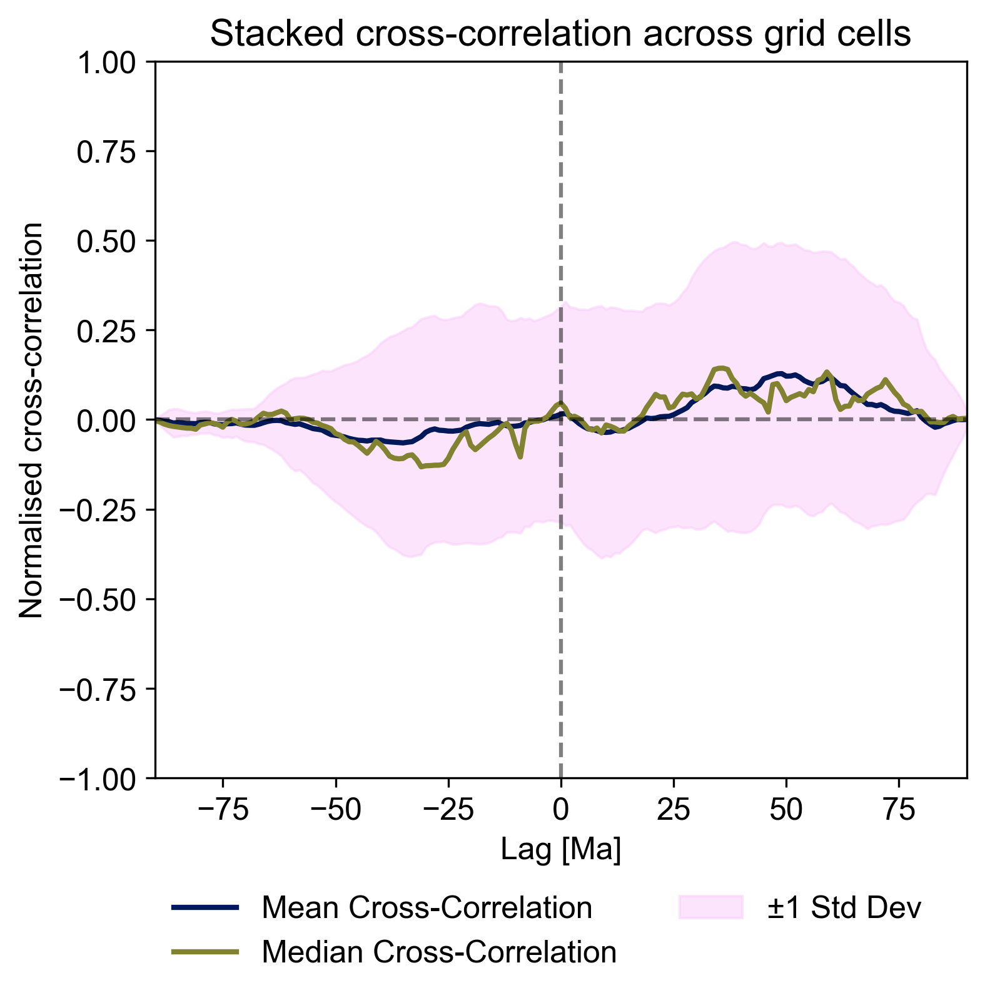

In [168]:
# Cross-correlation per grid cell
cross_corr_results = []

# Ensure all cross-correlation arrays will have the same length
max_lag_length = len(M2016.ages) * 2 - 1  # This would be the maximum possible lag length

for lat_idx in range(len(lat_bins)-1):
    for lon_idx in range(len(lon_bins)-1):
        flux_series = [grid_flux[age][lat_idx, lon_idx] for age in M2016.ages]
        pull_series = [grid_pull[age][lat_idx, lon_idx] for age in M2016.ages]

        # Only process non-zero flux values
        if np.all(np.array(flux_series) != 0):
            # Convert to NumPy arrays and handle NaNs
            flux_series = np.array(flux_series)
            pull_series = np.array(pull_series)
            valid_mask = ~np.isnan(flux_series) & ~np.isnan(pull_series)

            if np.sum(valid_mask) > 10:  # Ensure enough valid data points
                flux_series = flux_series[valid_mask]
                pull_series = np.where(np.isnan(pull_series[valid_mask]), 0, pull_series[valid_mask])

                # Compute cross-correlation
                flux_series_dev = flux_series - mean_flux
                pull_series_dev = pull_series - mean_pull

                # Compute cross-correlation
                corr = correlate(flux_series_dev, pull_series_dev, mode="full")

                # Normalize properly
                norm_factor = np.sqrt(np.sum(flux_series_dev**2) * np.sum(pull_series_dev**2))
                corr /= norm_factor

                # Pad shorter correlations to match the max lag length
                if len(corr) < max_lag_length:
                    padding = np.full(max_lag_length - len(corr), np.nan)
                    corr = np.concatenate([padding, corr])

                # Store result
                cross_corr_results.append(corr)

# Stack all cross-correlation results
cross_corr_results = np.vstack(cross_corr_results)  # Shape: (num_cells, num_lags)

# Compute mean and standard deviation of cross-correlation across all grid cells
mean_corr = np.nanmean(cross_corr_results, axis=0)
median_corr = np.nanmedian(cross_corr_results, axis=0)
std_corr = np.nanstd(cross_corr_results, axis=0)

# Lags (centered around zero)
lags = np.arange(-(max_lag_length // 2), max_lag_length // 2 + 1)

fig, ax = plt.subplots(figsize=(fig_width*cm2in, fig_height_graphs*cm2in*2), dpi=300)

# Plot all individual cross-correlation curves
# for corr in cross_corr_results:
#     ax.plot(lags, corr, color="gray", alpha=0.2)  # Light color for individual curves

# Plot mean cross-correlation
ax.plot(lags, mean_corr, label="Mean Cross-Correlation", color=plate_colours[0], linewidth=2)

# Plot median cross-correlation
ax.plot(lags, median_corr, label="Median Cross-Correlation", color=plate_colours[1], linewidth=2)

# Shaded region for ±1 standard deviation
ax.fill_between(lags, mean_corr - std_corr, mean_corr + std_corr, color=plate_colours[-1], alpha=0.5, label="±1 Std Dev")

# Reference lines
ax.axvline(0, linestyle="--", color="k", alpha=0.5)
ax.axhline(0, linestyle="--", color="k", alpha=0.5)

# Labels and title
ax.set_xlabel("Lag [Ma]")
ax.set_ylabel("Normalised cross-correlation")
ax.set_ylim(-1, 1)
ax.set_xlim(-90, 90)
ax.set_title("Stacked cross-correlation across grid cells")

# Add a legend below the entire figure
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc="lower center", ncol=2, frameon=False, bbox_to_anchor=(0.5, -0.125))

fig.savefig(os.path.join(figs_dir, "Stacked cross-correlation.png"), bbox_inches="tight")


In [ ]:
# Create a figure and gridspec
fig, ax = plt.subplots(figsize=(fig_width/4, fig_height_maps/4), subplot_kw={"projection": ccrs.Robinson(central_longitude = 160)}, dpi=300)

lats = []; lons = []; values = []
for age in M2016.ages:
    # Select data
    slab_data = M2016.slabs.data[age]["opt2"]

    if age < 36:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [608, 901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [608, 901])]
    elif age < 46:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [901])]
    elif age < 56:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs + [901])]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501, 901])]
    else:
        slab_data = slab_data[slab_data.lower_plateID.isin(plateIDs)]; slab_data_nnr = slab_data_nnr[slab_data_nnr.lower_plateID.isin(plateIDs + [501])]

    slab_flux = (slab_data.slab_lithospheric_thickness + slab_data.slab_crustal_thickness) * slab_data.convergence_velocity_mag * slab_data.trench_segment_length

    # Append values
    lats.extend(slab_data.lat.values); lons.extend(slab_data.lon.values); values.extend(slab_flux)

h = ax.hist2d(lons, lats, bins=[72, 36], cmap="cmc.devon_r",# range=[[-180, 180], [-90, 90]], 
          weights=values, transform=ccrs.PlateCarree(), norm=mcolors.LogNorm(vmin=1e12, vmax=5e13))

plot_M2016.plot_basemap(ax)
ax.coastlines(lw=0.5)
ax.set_global()

# Create a new grid for the colorbar
cax2 = fig.add_axes([0.412/4, -0.06, 0.8, 0.08])

# Create a colorbar below the subplots
cbar2 = plt.colorbar(h[3], cax=cax2, orientation="horizontal", extend="both")

# Set colorbar label
cbar2.set_label(r"Slab flux [m$^3$]", labelpad=5)